# Understading JUNO .npz datasets

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from tqdm import tqdm

In [2]:
import modules

# custom modules
%load_ext autoreload
%autoreload 1
%aimport modules.visualize_event 
%aimport modules.convert_pmt_ids
%aimport modules.plot_utils


In [3]:
colors = [
    "#fd7f6f", 
    "#7eb0d5", 
    "#b2e061", 
    "#bd7ebe", 
    "#ffb55a", 
    "#8bd3c7", 
    "#ffee65", 
    "#beb9db", 
    "#fdcce5"
 ]



white = "white"
black = "black"

## Load data

In [4]:
# PMT positions on the sphere
PMTPos_CD_LPMT    = pd.read_csv("../data/PMTPos_CD_LPMT.csv")
# PMT ID mapping
PMT_ID_conversion = pd.read_csv("../data/PMT_ID_conversion.csv")

# EVENTS
train_data        = np.load("../data/real/train/data/raw_data_train_4.npz", allow_pickle=True)["a"]
# TRUE ENERGY AND TRUE VERTEX OF THE EVENTS
train_label       = pd.read_csv("../data/real/train/targets/targets_train_4.csv")

# COMPUTE RADIUS FROM TRUE VERTEX
train_label["edepR"] = (train_label["edepX"]**2 + train_label["edepY"]**2 + train_label["edepZ"]**2)**0.5

## Inspect `train_data`

The shape of the `numpy.array` is

In [5]:
print(train_data.shape)

(3, 5000)


where the first index is the *feature* index

1. PMT ID
2. Charge
3. Hit time

and the second index is the *event* index, i.e. there are $5000$ events recorded.

Note that each *event* contains a variable number of hits! Thus, each entry of the array is an array itself.

Let us convert the `numpy.array` into a `pandas.DataFrame` to better visualize the connection between hits, events and features.

The first preprocess we apply is to remove hits with zero-hit-time, i.e. $ht=0$. 

We iterate over the events and keep only the hits with non-zero hit time: `train_data[2, :][i] != 0.0`.

We also convert the first feature, PMT ID, to a more readable format using the PMT mapping provided, i.e. the `PMT_ID_conversion.csv` file.

In [6]:
NEvents = train_data.shape[1]
for i in tqdm(range(NEvents)):
    # find non-zero-time hits
    nonzeros_inds = np.where(train_data[2, :][i] != 0.0)[0]
    # PMT ID mapping
    train_data[0, :][i] = modules.convert_pmt_ids.convert_pmt_ids(train_data[0, :][i], PMT_ID_conversion)
    # keep only non-zero hits
    train_data[0, :][i] = train_data[0, :][i][nonzeros_inds]
    train_data[1, :][i] = train_data[1, :][i][nonzeros_inds]
    train_data[2, :][i] = train_data[2, :][i][nonzeros_inds]
    
del i

100%|██████████| 5000/5000 [00:02<00:00, 1782.49it/s]


In [7]:
df = pd.DataFrame(train_data.T, columns=("pmt_id", "charge", "hit_time"))
df.head()

,pmt_id,charge,hit_time
0,"[0, 1, 2, 8, 14, 15, 18, 19, 20, 34, 40, 54, 6...","[1.0169096287452863, 1.289895357346751, 1.4573...","[278.5438428571429, 270.03612857142855, 263.31..."
1,"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...","[7.69295220634088, 6.316354197252007, 1.649539...","[204.54384285714283, 224.03612857142858, 225.0..."
2,"[17, 20, 27, 28, 32, 33, 35, 58, 60, 69, 72, 7...","[1.0770311814496256, 1.4405190900405578, 1.112...","[360.4588428571429, 1212.2837, 1169.9381085714..."
3,"[2, 15, 25, 40, 57, 62, 67, 85, 162, 166, 167,...","[1.481666113625243, 1.0454746500116843, 1.4914...","[288.6028228571429, 344.2614142857143, 568.777..."
4,"[9, 11, 19, 31, 37, 38, 43, 49, 51, 54, 60, 76...","[1.1243191985536116, 0.7539582292427174, 1.055...","[338.9815371428572, 499.8719857142857, 187.328..."


The index of the `pandas.dataframe` is the *event id*. Each event holds a number `n_hit` of hits and each hit is characterized by a `pmt_id` (the ID of the PMT that got hit), the collected `charge` and the `hit_time`. Note that the `hit_time` is computed event by event: it is an information to be used "inside" the event.

In [8]:
# add event_id column
df["event_id"] = np.arange(0, df.shape[0], 1)
df = df[["event_id", "pmt_id", "charge", "hit_time"]]  
df

,event_id,pmt_id,charge,hit_time
0,0,"[0, 1, 2, 8, 14, 15, 18, 19, 20, 34, 40, 54, 6...","[1.0169096287452863, 1.289895357346751, 1.4573...","[278.5438428571429, 270.03612857142855, 263.31..."
1,1,"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...","[7.69295220634088, 6.316354197252007, 1.649539...","[204.54384285714283, 224.03612857142858, 225.0..."
2,2,"[17, 20, 27, 28, 32, 33, 35, 58, 60, 69, 72, 7...","[1.0770311814496256, 1.4405190900405578, 1.112...","[360.4588428571429, 1212.2837, 1169.9381085714..."
3,3,"[2, 15, 25, 40, 57, 62, 67, 85, 162, 166, 167,...","[1.481666113625243, 1.0454746500116843, 1.4914...","[288.6028228571429, 344.2614142857143, 568.777..."
4,4,"[9, 11, 19, 31, 37, 38, 43, 49, 51, 54, 60, 76...","[1.1243191985536116, 0.7539582292427174, 1.055...","[338.9815371428572, 499.8719857142857, 187.328..."
...,...,...,...,...
4995,4995,"[0, 10, 17, 20, 21, 24, 38, 63, 70, 74, 94, 95...","[1.3254046656216911, 0.9855646448302391, 0.873...","[647.8295571428571, 284.6588428571428, 238.173..."
4996,4996,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","[5.069035289186772, 4.132075984757962, 2.83924...","[227.7504142857143, 222.74568, 213.60310857142..."
4997,4997,"[0, 3, 12, 38, 41, 42, 63, 78, 84, 97, 100, 10...","[1.0725858313803227, 1.1564229012651848, 1.020...","[671.5438428571427, 314.8888228571429, 373.645..."
4998,4998,"[1, 6, 7, 14, 15, 19, 27, 30, 33, 44, 46, 48, ...","[1.1584160901915277, 0.9035373743278005, 0.984...","[127.4647, 354.0911285714285, 376.112128571428..."


Here we expand the `pandas.DataFrame` to make it *hit-wise* instead of event-wise. Events will be tracked using the `event_id` column.

In [9]:
event_list = []
# for each event
for ev in tqdm(df["event_id"]):
    
    # number of hits in the event
    ev_shape = df["pmt_id"][ev].shape[0]
    # store features
    pmt      = df["pmt_id"][ev]
    q        = df["charge"][ev]
    ht       = df["hit_time"][ev]
    # replicate the event id
    ev_id    = [ev] * ev_shape
    
    # build the dataframe
    event_df = pd.DataFrame(np.array([ev_id, pmt, q, ht]).T, columns = ("ev_id", "pmt_id", "charge", "hit_time"))
    
    # store the event
    event_list.append(event_df)

# concatenate all events
data = pd.concat(event_list, ignore_index=True)


# delete for-loop variables
del ev
del event_list
del ev_shape
del pmt
del q
del ht
del ev_id
del event_df

100%|██████████| 5000/5000 [00:01<00:00, 3242.65it/s]


In [10]:
data

,ev_id,pmt_id,charge,hit_time
0,0.0,0.0,1.016910,278.543843
1,0.0,1.0,1.289895,270.036129
2,0.0,2.0,1.457318,263.317109
3,0.0,8.0,0.931422,267.299700
4,0.0,14.0,1.325459,329.878129
...,...,...,...,...
28344454,4999.0,17596.0,1.015088,363.252414
28344455,4999.0,17600.0,0.946382,375.834414
28344456,4999.0,17603.0,0.849958,378.658700
28344457,4999.0,17604.0,1.005972,295.039843


Now, if we need information of entire events, we simply need to use the `pandas.DataFrame.groupby()` function!

For example, let us inspect the number of hits inside each event. To do so, we *group by* the event id and compute the *size* of the output group. Then we make the histogram of such sizes!

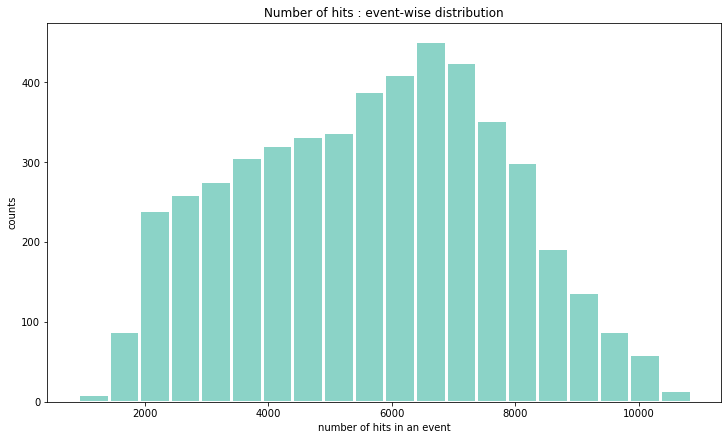

In [11]:
counts = data.groupby("ev_id")\
             .size()\
             .reset_index(name="counts")      


fig = plt.figure(figsize=(10,6), constrained_layout=True)

ax = modules.plot_utils.plot_feature_distribution(
    feature = counts["counts"],
    fig     = fig,
    bins    = 20,
    color   = colors[5]
)

ax.set_title("Number of hits : event-wise distribution")
ax.set_xlabel("number of hits in an event")
ax.set_ylabel("counts")
plt.show()

### Feature distributions

Before joining hit informations with the PMT mapping on the sphere, let us analyze briefly the feature distributions.

#### Charge

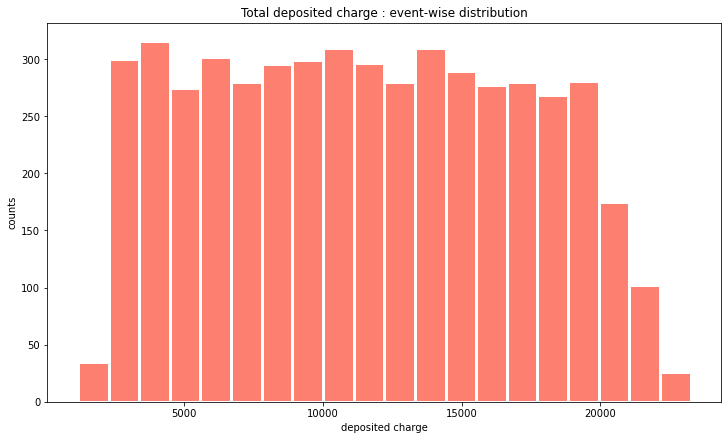

In [12]:
ev_total_features = data.groupby("ev_id")\
                        .sum()\
                        .reset_index()   


fig = plt.figure(figsize=(10,6), constrained_layout=True)

ax = modules.plot_utils.plot_feature_distribution(
    feature = ev_total_features["charge"],
    fig     = fig,
    bins    = 20,
    color   = colors[0]
)

ax.set_title("Total deposited charge : event-wise distribution")
ax.set_xlabel("deposited charge")
ax.set_ylabel("counts")
plt.show()

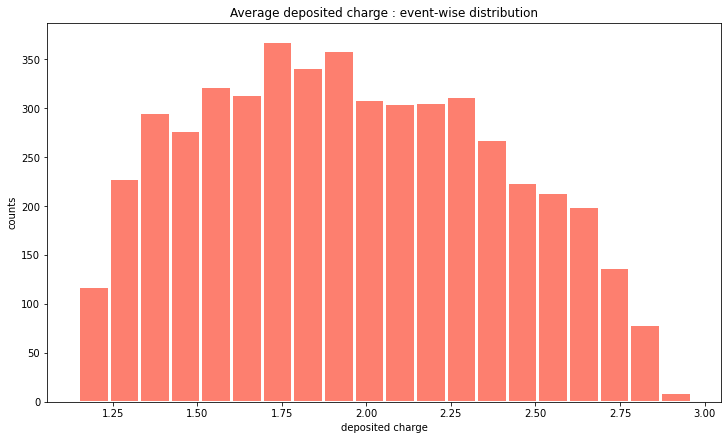

In [13]:
ev_average_features = data.groupby("ev_id")\
                          .mean()\
                          .reset_index()   

fig = plt.figure(figsize=(10,6), constrained_layout=True)

ax = modules.plot_utils.plot_feature_distribution(
    feature = ev_average_features["charge"],
    fig     = fig,
    bins    = 20,
    color   = colors[0]
)

ax.set_title("Average deposited charge : event-wise distribution")
ax.set_xlabel("deposited charge")
ax.set_ylabel("counts")
plt.show()

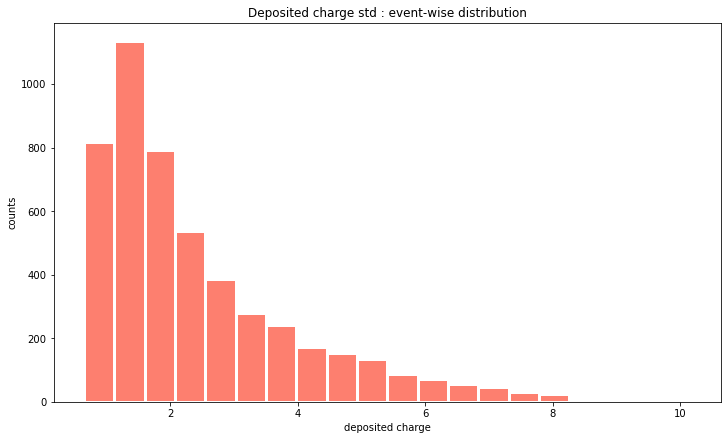

In [14]:
ev_features_std = data.groupby("ev_id")\
                      .std()\
                      .reset_index()   

fig = plt.figure(figsize=(10,6), constrained_layout=True)

ax = modules.plot_utils.plot_feature_distribution(
    feature = ev_features_std["charge"],
    fig     = fig,
    bins    = 20,
    color   = colors[0]
)

ax.set_title("Deposited charge std : event-wise distribution")
ax.set_xlabel("deposited charge")
ax.set_ylabel("counts")
plt.show()

#### Hit time

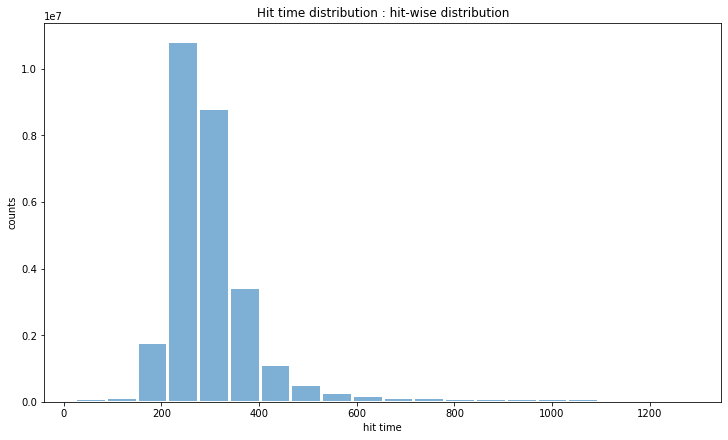

In [15]:
fig = plt.figure(figsize=(10,6), constrained_layout=True)

ax = modules.plot_utils.plot_feature_distribution(
    feature = data["hit_time"],
    fig     = fig,
    bins    = 20,
    color   = colors[1]
)

ax.set_title("Hit time distribution : hit-wise distribution")
ax.set_xlabel("hit time")
ax.set_ylabel("counts")

plt.show()

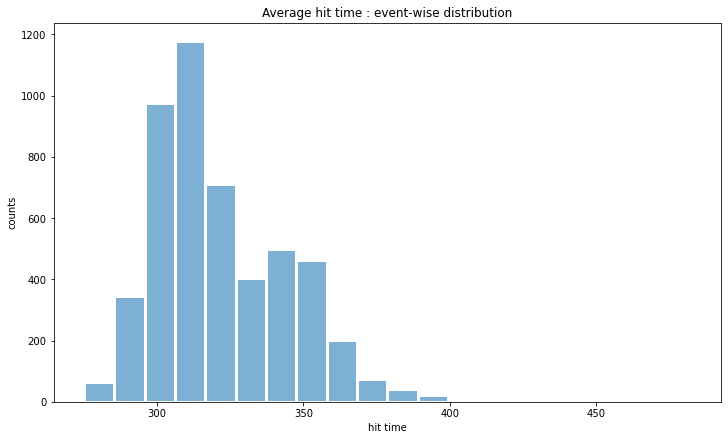

In [16]:
fig = plt.figure(figsize=(10,6), constrained_layout=True)

ax = modules.plot_utils.plot_feature_distribution(
    feature = ev_average_features["hit_time"],
    fig     = fig,
    bins    = 20,
    color   = colors[1]
)

ax.set_title("Average hit time : event-wise distribution")
ax.set_xlabel("hit time")
ax.set_ylabel("counts")
plt.show()

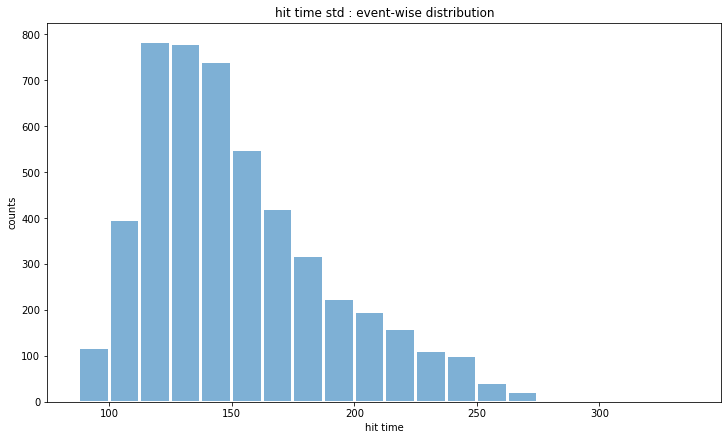

In [17]:
fig = plt.figure(figsize=(10,6), constrained_layout=True)

ax = modules.plot_utils.plot_feature_distribution(
    feature = ev_features_std["hit_time"],
    fig     = fig,
    bins    = 20,
    color   = colors[1]
)

ax.set_title("hit time std : event-wise distribution")
ax.set_xlabel("hit time")
ax.set_ylabel("counts")
plt.show()

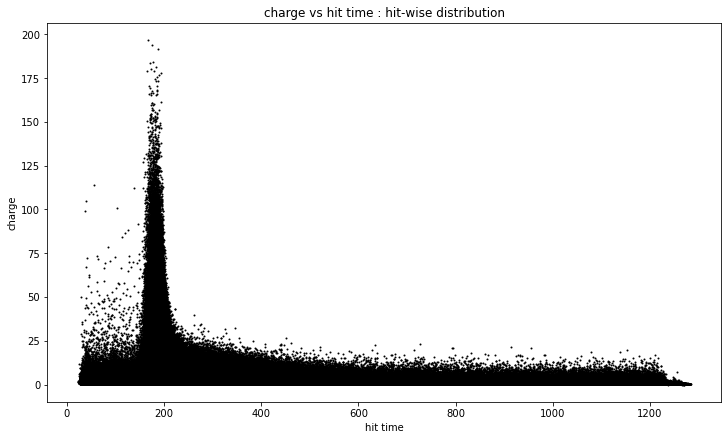

In [31]:
fig = plt.figure(figsize=(10,6), constrained_layout=True)

ax = modules.plot_utils.plot_feature_correlation(
    x     = data["hit_time"],
    y     = data["charge"],
    fig   = fig,
    color = black,
    size  = 1
)

ax.set_title("charge vs hit time : hit-wise distribution")
ax.set_xlabel("hit time")
ax.set_ylabel("charge")

plt.show()

## Join `train_data` with `PMTPos_CD_LPMT`

In [19]:
data.head()

,ev_id,pmt_id,charge,hit_time
0,0.0,0.0,1.016910,278.543843
1,0.0,1.0,1.289895,270.036129
2,0.0,2.0,1.457318,263.317109
3,0.0,8.0,0.931422,267.299700
4,0.0,14.0,1.325459,329.878129


In [20]:
PMTPos_CD_LPMT.head()

,PMTID,x,y,z,R,theta,phi
0,0,-930.2976,-111.8724,19365.0,19387.655713,0.0,0.0
1,1,-492.5657,-797.0872,19365.0,19387.655711,0.0,0.0
2,2,316.0782,-882.0791,19365.0,19387.655711,0.0,0.0
3,3,886.7088,-302.8474,19365.0,19387.655713,0.0,0.0
4,4,789.6295,504.4345,19365.0,19387.655710,0.0,0.0


In [21]:
data_pmt = pd.merge(data, PMTPos_CD_LPMT, how = "left", left_on = "pmt_id", right_on = "PMTID")\
             .drop("PMTID", axis = 1)
data_pmt

,ev_id,pmt_id,charge,hit_time,x,y,z,R,theta,phi
0,0.0,0.0,1.016910,278.543843,-930.2976,-111.8724,19365.0,19387.655713,0.0,0.0
1,0.0,1.0,1.289895,270.036129,-492.5657,-797.0872,19365.0,19387.655711,0.0,0.0
2,0.0,2.0,1.457318,263.317109,316.0782,-882.0791,19365.0,19387.655711,0.0,0.0
3,0.0,8.0,0.931422,267.299700,-1001.8845,-956.3302,19365.0,19414.467930,0.0,0.0
4,0.0,14.0,1.325459,329.878129,1317.6029,426.9224,19365.0,19414.467933,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...
28344454,4999.0,17596.0,1.015088,363.252414,910.4179,-1043.7812,-19365.0,19414.467928,180.0,0.0
28344455,4999.0,17600.0,0.946382,375.834414,815.0244,1119.8550,-19365.0,19414.467930,180.0,0.0
28344456,4999.0,17603.0,0.849958,378.658700,-972.9179,985.7260,-19365.0,19414.464968,180.0,0.0
28344457,4999.0,17604.0,1.005972,295.039843,-1273.1379,545.3989,-19365.0,19414.467932,180.0,0.0


In [22]:
data_pmt.describe()

,ev_id,pmt_id,charge,hit_time,x,y,z,R,theta,phi
count,2.834446e+07,2.834446e+07,2.834446e+07,2.834446e+07,2.834446e+07,2.834446e+07,2.834446e+07,2.834446e+07,2.834446e+07,2.834446e+07
mean,2.502261e+03,8.814886e+03,2.034666e+00,3.158529e+02,6.806350e+01,-2.227674e+01,-2.402059e+01,1.943393e+04,9.008873e+01,1.796467e+02
std,1.443043e+03,5.070984e+03,3.041107e+00,1.439642e+02,1.133727e+04,1.133547e+04,1.098387e+04,1.515058e+00,3.813797e+01,1.044321e+02
min,0.000000e+00,0.000000e+00,-2.773581e-02,2.282041e+01,-1.943259e+04,-1.942929e+04,-1.936500e+04,1.938766e+04,0.000000e+00,0.000000e+00
25%,1.245000e+03,4.433000e+03,9.183118e-01,2.434664e+02,-9.837048e+03,-9.981284e+03,-9.535862e+03,1.943400e+04,6.061480e+01,8.896550e+01
50%,2.511000e+03,8.813000e+03,1.236019e+00,2.823138e+02,1.182993e+02,-2.000000e-04,-2.271948e+02,1.943400e+04,9.066980e+01,1.798356e+02
75%,3.753000e+03,1.320500e+04,2.111793e+00,3.335018e+02,9.989146e+03,9.905742e+03,9.535862e+03,1.943400e+04,1.193852e+02,2.702466e+02
max,4.999000e+03,1.761100e+04,1.967812e+02,1.283251e+03,1.943259e+04,1.942929e+04,1.936500e+04,1.943400e+04,1.800000e+02,3.599345e+02


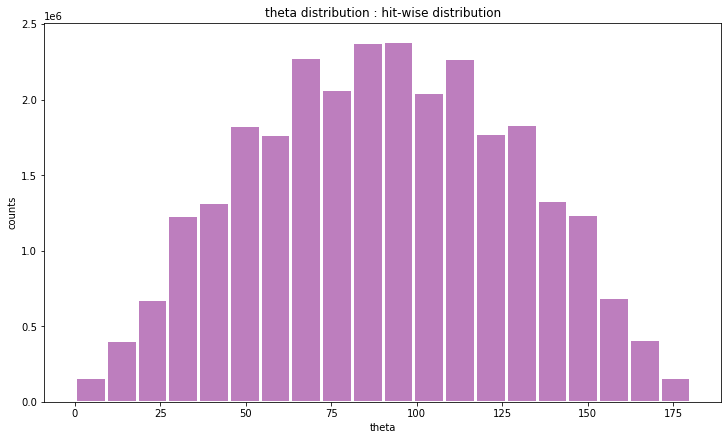

In [23]:
fig = plt.figure(figsize=(10,6), constrained_layout=True)

ax = modules.plot_utils.plot_feature_distribution(
    feature = data_pmt["theta"],
    fig     = fig,
    bins    = 20,
    color   = colors[3]
)

ax.set_title("theta distribution : hit-wise distribution")
ax.set_xlabel("theta")
ax.set_ylabel("counts")
plt.show()

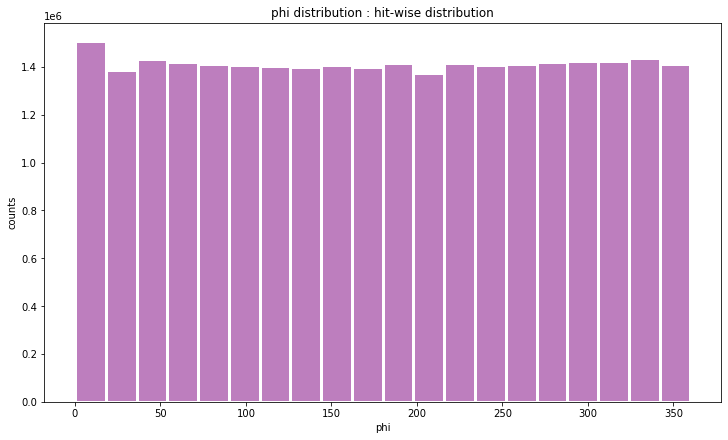

In [24]:
fig = plt.figure(figsize=(10,6), constrained_layout=True)

ax = modules.plot_utils.plot_feature_distribution(
    feature = data_pmt["phi"],
    fig     = fig,
    bins    = 20,
    color   = colors[3]
)

ax.set_title("phi distribution : hit-wise distribution")
ax.set_xlabel("phi")
ax.set_ylabel("counts")
plt.show()

In [25]:
random_evts = np.random.randint(0, 5000, 8)

events = data_pmt[data_pmt["ev_id"].isin(random_evts)]

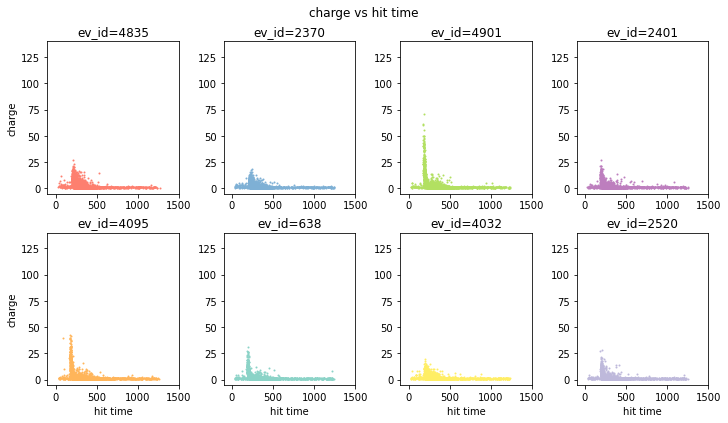

In [26]:
fig = plt.figure(figsize=(10,10), constrained_layout=True)

for i in range(random_evts.shape[0]):
    
    mask = (events["ev_id"]==random_evts[i])
    
    ax = modules.plot_utils.plot_feature_correlation(
        x      = events[mask]["hit_time"],
        y      = events[mask]["charge"],
        fig    = fig,
        color  = colors[i],
        size   = 1, 
        sub_id = 441 + i,
    )
    
    ax.sharex(ax)

    ax.set_title(f"ev_id={random_evts[i]}")
    
    if i > 3:
        ax.set_xlabel("hit time")  
    if i in (0, 4):
        ax.set_ylabel("charge")
    
    ax.set_xlim(-100, 1500)
    ax.set_ylim(-5,   140)

fig.suptitle("charge vs hit time")



plt.show()

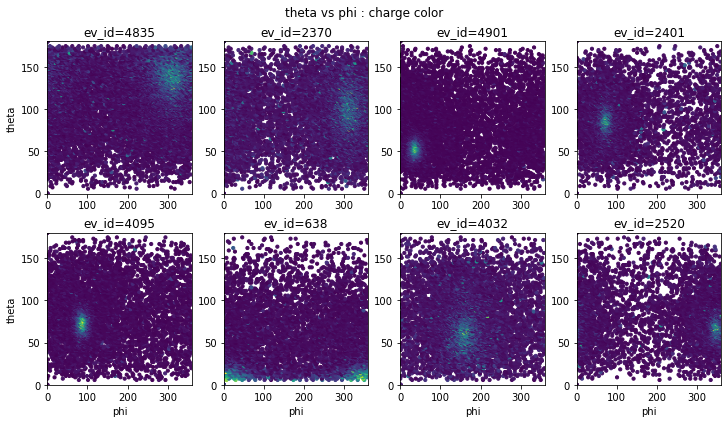

In [27]:
fig = plt.figure(figsize=(10,10), constrained_layout=True)

for i in range(random_evts.shape[0]):
    
    mask = (events["ev_id"]==random_evts[i])
    
    ax = modules.plot_utils.plot_feature_correlation_hue(
        x      = events[mask]["phi"],
        y      = events[mask]["theta"],
        fig    = fig,
        c      = events[mask]["charge"],
        size   = 10, 
        sub_id = 441 + i,
    )
    
    ax.sharex(ax)

    ax.set_title(f"ev_id={random_evts[i]}")
    
    if i > 3:
        ax.set_xlabel("phi")  
    if i in (0, 4):
        ax.set_ylabel("theta")
    
    ax.set_xlim(0, 360)
    ax.set_ylim(0, 180)

fig.suptitle("theta vs phi : charge color")



plt.show()

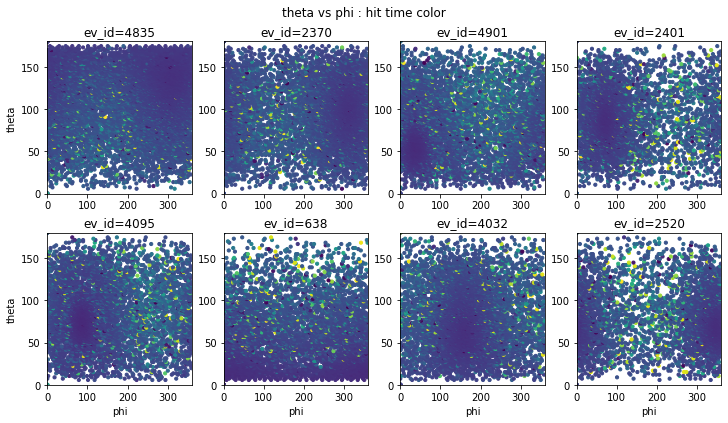

In [28]:
fig = plt.figure(figsize=(10,10), constrained_layout=True)

for i in range(random_evts.shape[0]):
    
    mask = (events["ev_id"]==random_evts[i])
    
    ax = modules.plot_utils.plot_feature_correlation_hue(
        x      = events[mask]["phi"],
        y      = events[mask]["theta"],
        fig    = fig,
        c      = events[mask]["hit_time"],
        size   = 10, 
        sub_id = 441 + i,
    )
    
    ax.sharex(ax)

    ax.set_title(f"ev_id={random_evts[i]}")
    
    if i > 3:
        ax.set_xlabel("phi")  
    if i in (0, 4):
        ax.set_ylabel("theta")
    
    ax.set_xlim(0, 360)
    ax.set_ylim(0, 180)

fig.suptitle("theta vs phi : hit time color")



plt.show()

Ideas:

- event wise center of charge radius distribution (using pmt locations)
- event wise hit time center distribution (using pmt location)
- event wise 3d scatter (see below)

In [29]:
def compute_center_q(df, ids):
    x_cq = np.zeros(len(ids))
    y_cq = np.zeros(len(ids))
    z_cq = np.zeros(len(ids))
    for i, id in enumerate(ids):
        mask = (df["ev_id"]==id)
        
        x_cq[i] = np.sum(df[mask]["x"] * df[mask]["charge"]) / np.sum(df[mask]["charge"])
        y_cq[i] = np.sum(df[mask]["y"] * df[mask]["charge"]) / np.sum(df[mask]["charge"])
        z_cq[i] = np.sum(df[mask]["z"] * df[mask]["charge"]) / np.sum(df[mask]["charge"])
    
    R_cq = (x_cq**2 + y_cq**2 + z_cq**2)**0.5    
    
    return np.array([x_cq, y_cq, z_cq, R_cq])
    
def compute_center_ht(df, ids, eps=50):
    x_cht = np.zeros(len(ids))
    y_cht = np.zeros(len(ids))
    z_cht = np.zeros(len(ids))
    for i, id in enumerate(ids):
        mask = (df["ev_id"]==id)
        
        x_cht[i] = np.sum(df[mask]["x"] / (df[mask]["hit_time"] + eps)) / np.sum(1 / (df[mask]["hit_time"] + eps))
        y_cht[i] = np.sum(df[mask]["y"] / (df[mask]["hit_time"] + eps)) / np.sum(1 / (df[mask]["hit_time"] + eps))
        z_cht[i] = np.sum(df[mask]["z"] / (df[mask]["hit_time"] + eps)) / np.sum(1 / (df[mask]["hit_time"] + eps))
        
    R_cht = (x_cht**2 + y_cht**2 + z_cht**2)**0.5
    
    return np.array([x_cht, y_cht, z_cht, R_cht])
    

In [37]:
cqs  = compute_center_q(df=data_pmt, ids=np.arange(0, 5000, 1))
chts = compute_center_ht(df=data_pmt, ids=np.arange(0, 5000, 1))

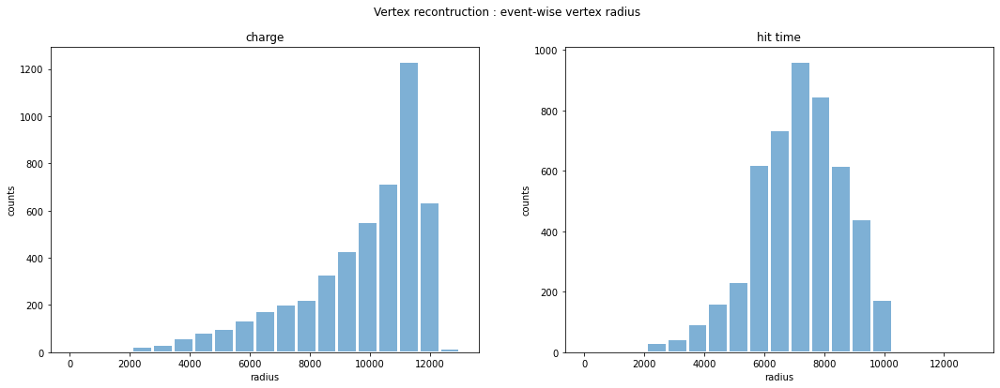

In [40]:
fig = plt.figure(figsize=(18, 6))
fig.suptitle("Vertex recontruction : event-wise vertex radius")

ax = modules.plot_utils.plot_feature_distribution(
    feature = cqs[-1],
    fig     = fig,
    sub_id  = 121,
    bins    = np.linspace(0, 13000, 20) 
)

ax.set_title("charge")
ax.set_xlabel("radius")
ax.set_ylabel("counts")

ax = modules.plot_utils.plot_feature_distribution(
    feature = chts[-1],
    fig     = fig,
    sub_id  = 122,
    bins    = np.linspace(0, 13000, 20) 
)

ax.set_title("hit time")
ax.set_xlabel("radius")
ax.set_ylabel("counts")

plt.show()

### Check true values using labels

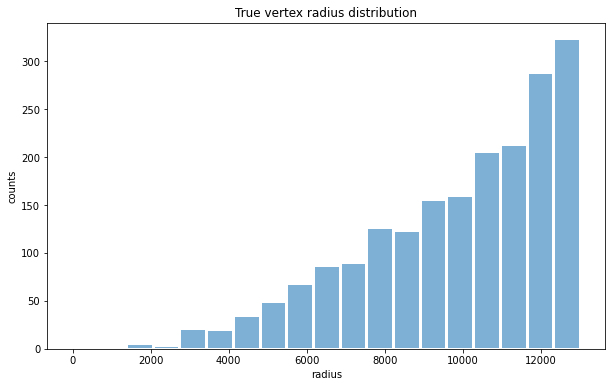

In [45]:
fig = plt.figure(figsize=(10, 6))

ax = modules.plot_utils.plot_feature_distribution(
    feature = train_label["edepR"]*1000,
    fig     = fig,
    sub_id  = 111,
    bins    = np.linspace(0, 13000, 20) 
)

ax.set_title("True vertex radius distribution")
ax.set_xlabel("radius")
ax.set_ylabel("counts")


plt.show()

THe true vertex radius distribution shape is similar to the center of charge radius, but quite different to the vertex reconstructed using time information.

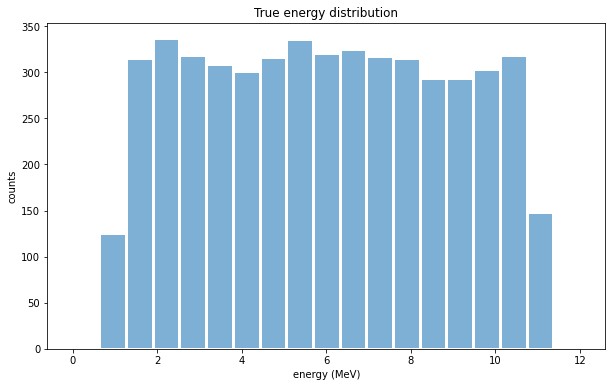

In [51]:
fig = plt.figure(figsize=(10, 6))

ax = modules.plot_utils.plot_feature_distribution(
    feature = train_label["edep"],
    fig     = fig,
    sub_id  = 111,
    bins    = np.linspace(0, 12, 20) 
)

ax.set_title("True energy distribution")
ax.set_xlabel("energy (MeV)")
ax.set_ylabel("counts")


plt.show()

The true energy distribution shape is close to the total charge distribution we have shown above!

## 3D Reconstruction

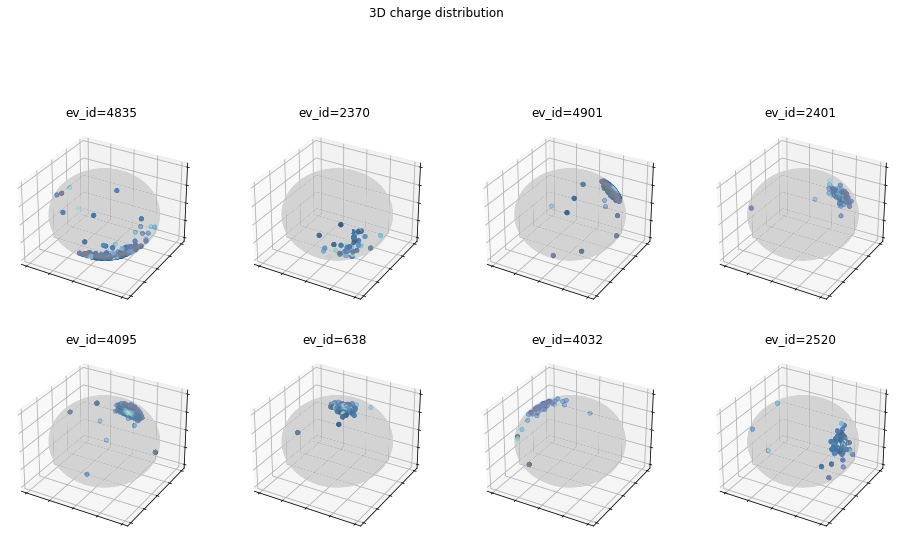

In [64]:
fig = plt.figure(figsize = (16, 16))
fig.suptitle("3D charge distribution")

for i in range(random_evts.shape[0]):
    
    mask = (events["ev_id"]==random_evts[i])
    q_cut = (events["charge"]>10)
    
    ax = fig.add_subplot(441 + i, projection="3d")
    ax.set_title(f"ev_id={random_evts[i]}")
    
    sphere = ax.scatter(
        xs    = PMTPos_CD_LPMT["x"],
        ys    = PMTPos_CD_LPMT["y"], 
        zs    = PMTPos_CD_LPMT["z"], 
        color = "lightgray", 
        alpha = 0.01
    )

    points = ax.scatter(
        xs   = events[mask & q_cut]["x"], 
        ys   = events[mask & q_cut]["y"],
        zs   = events[mask & q_cut]["z"],
        c    = events[mask & q_cut]["charge"],
        cmap = "GnBu_r"
    )

    ax.set_xticklabels("")
    ax.set_yticklabels("")
    ax.set_zticklabels("")
    # fig.colorbar(points)
    
plt.show()

In [65]:
random_evts = np.random.randint(0, 5000, 7)
R_array = np.array(PMTPos_CD_LPMT["R"][random_evts]) / 1000.

lpmt_x_array = []
lpmt_y_array = []
lpmt_z_array = []

for i in range(len(random_evts)):
    lpmt_x = np.array(PMTPos_CD_LPMT["x"][train_data[0, :][random_evts[i]]]) / 1000.
    lpmt_y = np.array(PMTPos_CD_LPMT["y"][train_data[0, :][random_evts[i]]]) / 1000.
    lpmt_z = np.array(PMTPos_CD_LPMT["z"][train_data[0, :][random_evts[i]]]) / 1000.

    lpmt_x_array.append(lpmt_x)
    lpmt_y_array.append(lpmt_y)
    lpmt_z_array.append(lpmt_z)

lpmt_charge_array = train_data[1, :][random_evts]
lpmt_fht_array    = train_data[2, :][random_evts]

event_edep_array  = np.array(train_label["edep"][random_evts])
event_Redep_array = np.array(train_label["edepR"][random_evts])
event_pos_x_array = np.array(train_label["edepX"][random_evts])
event_pos_y_array = np.array(train_label["edepY"][random_evts])
event_pos_z_array = np.array(train_label["edepZ"][random_evts])

modules.visualize_event.visualize_events(
    random_evts,
    R_array.mean(),
    lpmt_x_array,
    lpmt_y_array,
    lpmt_z_array,
    lpmt_charge_array,
    lpmt_fht_array,
    event_pos_x_array,
    event_pos_y_array,
    event_pos_z_array,
    event_edep_array,
    event_Redep_array,
    subplots       = True,
    colorscale_fht = "ice",
    cc_show        = True,
    cht_show       = True,
    save           = False
)